# Photo Renaming Tool

There's two parts to this tool, the folder containing the files and the excel sheet with the full file names in column A, and the new file names in column B.

How you run the tool depends on the if the excel sheet has already be created or not.

Best practice is probably to update the civilpy package prior to executing the cells (remove the `# ` to update the the civilpy package 

In [2]:
# %pip install --upgrade civilpy

## Excel Sheet

Create an empty excel sheet, paste the path to the empty sheet in the `excel_file` variable below, run both cells by hitting "shift+enter", copy the output values into column `A` of the excel sheet, update column `B` within the excel sheet to the correct values, scroll down to the bottom of the output where it says `Copy the files and names into the excel sheet, then hit "enter"`, select the text box, and hit enter. A new folder will be created in the folder you specified as `path_to_photos` called `Renamed_Photos` and the renamed photos will be located in there.

Troubleshooting: The script will not run if the excel file is still open on the user's computer, or if the `Renamed_Photos` folder or any of the files in it already exist. 

In [ ]:
# Replace the following path with the location to the photos folder and excel file, note the 'r' before the path
path_to_photos = r"C:\Users\dane.parks\Projects\Coopers WV\Coopers Photos"
excel_file = r"C:\Users\dane.parks\Projects\Coopers WV\Coopers Photos\Photo Renaming Example.xlsx"

In [1]:
# You shouldn't need to change any values in this cell, just run it, update the excel sheet with the copied values, then hit 'enter' again
from civilpy.general.photos import photo_renaming_tool

photo_renaming_tool(root_folder=path_to_photos, excel_file=excel_file)

NameError: name 'path_to_photos' is not defined

## Photo Resizing

In [5]:
#!/usr/bin/python
from PIL import Image
import os, sys

path = "./res/imgs/Terminals/"
dirs = os.listdir(path)


def resize():
    for item in dirs:
        if os.path.isfile(path + item):
            im = Image.open(path + item)
            f, e = os.path.splitext(path + item)
            imResize = im.resize((1187, 850), Image.LANCZOS)
            img_rgb = im.convert("RGB")
            img_rgb.save(f + "-resized.jpg", "JPEG", quality=90)


resize()

# Encode as Base64

(Lets you embed images directly inside of html files instead of referencing the file)

In [16]:
# Encode the above images for embedding
import base64
from PIL import Image
from io import BytesIO

with open("./res/imgs/training_docs/ADS14.png", "rb") as image_file:
    data = base64.b64encode(image_file.read())
    print(f"data:image/png;base64, {data}")

# im = Image.open(BytesIO(base64.b64decode(data)))
# im.save('image1.png', 'PNG')

data:image/png;base64, b'iVBORw0KGgoAAAANSUhEUgAAAOkAAAFECAIAAABNoI4wAAAAAXNSR0IArs4c6QAAAARnQU1BAACxjwv8YQUAAAAJcEhZcwAADsMAAA7DAcdvqGQAAAASdEVYdFNvZnR3YXJlAEdyZWVuc2hvdF5VCAUAAEYrSURBVHhe7b15VBtZnqBbZ97pbbqnp1539fTMnKmurunTr6ejhJYUEpJSCBAo2ffVQIEBYzBgwBtgG7PZGAuDWY1sMIuVeMckTuOFNOAFDNisAgFik7GNc+2qzD6zVFfPH/1u6EohKRTCAgMmnNfnSzLixi/uvRHxcXUVSL/4SXdv/4NrimNBQleZ16/s2AjE9ge6+hOR4R9yF0EXkLsIuoLcRdAV5C6Crujd/Ztf/HcIchdBF5C7CLqC3EXQFeQugq4gdxF0BbmLoCvIXQRdQe4i6ApyF0FX9O6Gl/d19/YDkLsIuqB398GlHMe/+SWNxl2MEXji/sTwiI5ng/c7rpTt9eMyWKQwAntpcHCIt4MuAGOlXRiZaMv1NA14R/T9aUxn2taHLeO9NLo16N3dJ8HFpZW7oZXPVrTP7yoUDYr6T691Ty0uL3Vky0hhBMHVo9qFq7v17u6/sbzSVehuGvCO6PvTlrWKu6Z92DLeS6Nbg97dcN2gSz93Da5gjJCKoRVtX0V04snSsuxAtv5S2YfllJYVZ+6XX+jSaLWDrWWVR6KdoLudBaHhmcfLa8+e2B8psjNeWr5/2pGSuury4sxImb5yu6CMsspD0YE79heX19YUpYfwLFQg+mPHCKQMliWZ9QHuxffD26qpkGeGO9uZthUbtutopUKR7a2rLSs6IPpweXVtVX5GpKOuq6QwH92+lrWtr1FY2/bng3HXPuP6S+3UxbjEVvXyYkuSva6Qn3Z1SatSHj3dMzT1UvtiYbh/6NpRb+ju+Njk4uLsCChffj10Lp6jq8cl/cqzxZUF9fjg+NL

# Inversing Image Color

In [4]:
path_to_image = r"D:\MB Projects\Port of Conneaut\RR Coordination\City Documents\1830's plat establishment document\1830 - Thompson Rd Book B Pg6-8 Page 001.jpg"
path_to_inverted_image = r"D:\MB Projects\Port of Conneaut\RR Coordination\City Documents\1830's plat establishment document\1830 - Thompson Rd Book B Pg6-8 Page 001-inverted.jpg"

In [5]:
from PIL import Image
import PIL.ImageOps

image = Image.open(path_to_image)

inverted_image = PIL.ImageOps.invert(image)

inverted_image.save(path_to_inverted_image)

# Application for Editing Photos - MDTA

Stored in `civilpy.state.maryland.mdta_photo_editor`

In [1]:
from openpyxl import Workbook
from pathlib import Path
import os

In [2]:
def generate_excel(folder, extension):
    path = Path(folder)
    wb = Workbook()
    ws = wb.active
    ws.append(["Files"])
    ws[f'B1'] = "New Names"

    if folder != "" and path.is_dir():
        files = list(path.glob("*.*"))
        lst = [
            file
            for file in files
            if file.suffix.lower() in extension
            and file.is_file()
        ]

    max_length = 0
    
    for i, file in enumerate(lst):
        if len(str(file)) > max_length:
            max_length = len(str(file))
            ws[f'A{i+2}'] = str(file)
        else:
            ws[f'A{i+2}'] = str(file)

    ws.column_dimensions["A"].width = max_length + 2
    ws.column_dimensions["B"].width = max_length + 2

    output_file = path / 'photo_names.xlsx'
    wb.save(output_file)
    os.startfile(output_file)

In [3]:
generate_excel("D:\\MB Projects\\HBG 3rd mainline\\Photos\\SQT Files", (".png", ".gif", ".jpg", ".tif"))

Resizing the images and adding timestamps to them:

In [3]:
from PIL import Image, ImageDraw, ImageFont, ExifTags
from datetime import datetime

In [16]:
def resize_image(img, width=1024, height=768, bar_color=(0, 0, 0)):
    """
    Resize an image while preserving the aspect ratio and add vertical (or horizontal) bars
    to fit the image in the specified width and height.

    Args:
        image_path (str): Path to the input image.
        output_path (str): Path to save the resized image.
        width (int): Target width of the final image.
        height (int): Target height of the final image.
        bar_color (tuple): RGB color for the bars (default is black).
    """
    try:
        # Preserve aspect ratio by resizing into a box
        img.thumbnail((width, height), Image.LANCZOS)

        # Create a new image with the target dimensions and bar color
        new_image = Image.new("RGB", (width, height), bar_color)

        # Center the resized image on the new canvas
        x_offset = (width - img.width) // 2
        y_offset = (height - img.height) // 2
        new_image.paste(img, (x_offset, y_offset))

        return new_image

    except Exception as e:
        print(f"Error: {e}")

In [35]:
from PIL.ExifTags import TAGS

def get_photo_creation_date(img):
    """
    Extracts the creation date of a photo from its EXIF metadata
    and returns it in MM/DD/YYYY format.

    :param file_path: Path to the image file
    :return: Creation date in MM/DD/YYYY format, or None if not available
    """
    # Get EXIF data
    exif_data = img.getexif()
    
    if not exif_data:
        print("No EXIF data found in the image.")
        return None

    date = exif_data.get(36867)
    if date is None:
        date = exif_data.get(306)
    formatted_date = datetime.strptime(date, "%Y:%m:%d %H:%M:%S")

    return formatted_date.strftime("%m/%d/%Y %H:%M")

In [44]:
img = Image.open(r"C:\Users\dane.parks\Downloads\test\P1140038.JPG")

In [45]:
date = get_photo_creation_date(img)
date

'01/14/2025 12:56'

In [46]:
img.getexif().get(306)

'2025:01:14 12:56:12'

In [18]:
def add_timestamp(image, date):
    """
    Adds a timestamp with date and time extracted from an image's metadata
    (if available) to the bottom right of the image.

    Args:
        image (PIL.Image.Image): An Image object.

    Returns:
        PIL.Image.Image: The modified image with the timestamp.
    """
    try:
        date = datetime.strptime(date, "%m/%d/%Y %H:%M")
        # Convert to "MM/DD/YYYY HH:MM" format
        timestamp_text = date.strftime("%m/%d/%Y %H:%M")

        # Prepare drawing context
        draw = ImageDraw.Draw(image)
        try:
            # Try loading a truetype font (e.g., Arial)
            font = ImageFont.truetype("arial.ttf", size=36)
        except IOError:
            # Fallback to a default PIL font if the font is missing
            font = ImageFont.load_default()

        # Calculate text size using textbbox
        text_bbox = draw.textbbox((0, 0), timestamp_text, font=font)
        text_width = text_bbox[2] - text_bbox[0]
        text_height = text_bbox[3] - text_bbox[1]

        # Determine position for the text (bottom-right corner with padding)
        x = image.width - text_width - 10  # 10-pixel padding from the right
        y = image.height - text_height - 10  # 10-pixel padding from the bottom

        # Add the timestamp to the image
        draw.text((x, y), timestamp_text, fill="white", font=font)

        return image

    except Exception as e:
        print(f"Error: {e}")
        return None


In [40]:
image = add_timestamp(img, date)

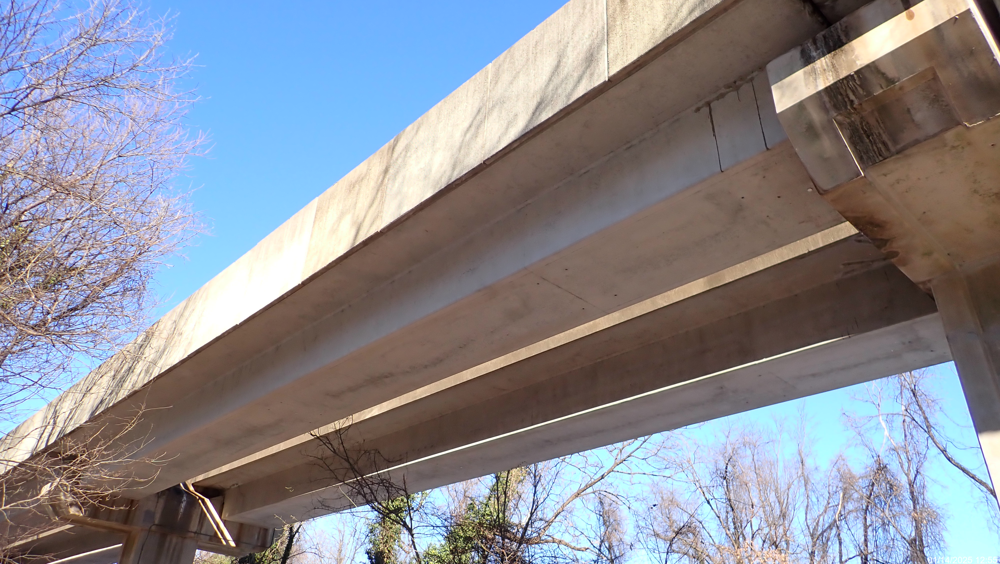

In [41]:
image

In [9]:
file = r"C:\Users\dane.parks\Downloads\test\P1140036.JPG"

In [10]:
image = Image.open(file)
image
exif = image._getexif()

In [11]:
get_photo_creation_date(image)

'01/14/2025 12:55'

In [20]:
from pathlib import Path
import os

In [21]:
path = Path(r"C:\Users\dane.parks\Downloads\test")
files = list(path.glob("*.*"))
for file in files:
    if file.suffix == '.mp4' or file.suffix == '.xlsx':
        continue
        
    image = Image.open(file)
    creation_date = get_photo_creation_date(image)

    image = resize_image(image)
    
    image = add_timestamp(image, creation_date)

    if not os.path.isdir(path / 'Renamed_Photos'):
        os.mkdir(path / 'Renamed_Photos')
    
    image.save(file.parent / 'Renamed_Photos' / file.name)

In [152]:
creation_date

'09/12/2024 14:42'

In [84]:
image = Image.open(files[0])

In [85]:
image = resize_image(image)

In [86]:
image = add_timestamp(image)

In [ ]:
image.save(file.parent / 'Renamed_Photos' / file.name